# Top2Vec

In [1]:
from top2vec import Top2Vec

In [2]:
import pandas as pd

In [3]:
# load messages
messages = pd.read_csv('messages_100k.csv')
messages = messages['message'].tolist()

In [4]:
model = Top2Vec(documents=messages, speed="learn", workers=8)

2020-11-20 15:36:27,490 - top2vec - INFO - Pre-processing documents for training
2020-11-20 15:36:35,929 - top2vec - INFO - Creating joint document/word embedding
2020-11-20 15:44:20,136 - top2vec - INFO - Creating lower dimension embedding of documents
2020-11-20 15:45:16,043 - top2vec - INFO - Finding dense areas of documents
2020-11-20 15:45:20,184 - top2vec - INFO - Finding topics


In [5]:
model.get_num_topics()

1593

Why so many?

In [6]:
topic_sizes, topic_nums = model.get_topic_sizes()

In [7]:
topic_sizes

array([1253,  859,  470, ...,   19,   19,   19])

In [8]:
topic_nums

array([   0,    1,    2, ..., 1590, 1591, 1592])

Biggest topic only has 1253 documents.

In [39]:
# get words for top topics
topic_words, word_scores, topic_nums = model.get_topics(10)

In [40]:
for i, words in enumerate(topic_words):
    print(f"Top words for topic {i + 1}\n{words}\n")

Top words for topic 1
['tell' 'similar' 'plans' 'units' 'more' 'floor' 'unit' 'hi' 'thanks'
 'interested' 'floorplans' 'or' 'upcoming' 'ongoing' 'can' 'am' 'under'
 'learning' 'bedroom' 'with' 'me' 'availability' 'linda' 'dimensions'
 'plan' 'john' 'dining' 'rachel' 'scheduling' 'matthew' 'brittany'
 'bedroomss' 'samantha' 'kelly' 'in' 'cost' 'mary' 'photos' 'studio' 'any'
 'grace' 'balcony' 'pricing' 'share' 'lisa' 'images' 'available' 'taylor'
 'approx' 'you']

Top words for topic 2
['bedroomss' 'abodo' 'ongoing' 'upcoming' 'ia' 'flexed' 'learning'
 'thompson' 'mfte' 'zumper' 'bth' 'padmapper' 'posting' 'mini' 'fheps'
 'plz' 'jul' 'laura' 'queen' 'html' 'linda' 'jun' 'townhome' 'sfbay'
 'tiffany' 'apa' 'bdr' 'vista' 'shortest' 'approx' 'matthew' 'joe' 'flex'
 'soonest' 'blvd' 'schools' 'newly' 'wheelchair' 'boston' 'wilshire' 'ur'
 'towers' 'accepts' 'openings' 'kayla' 'slot' 'hookups' 'fiancee' 'adam'
 'victoria']

Top words for topic 3
['abodo' 'bedroomss' 'walkthrough' 'video' 'la

In [41]:
topic_nums

array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9])

Create word clouds.

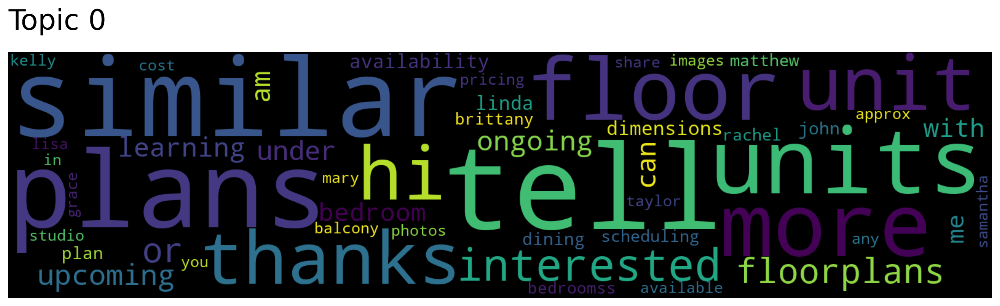

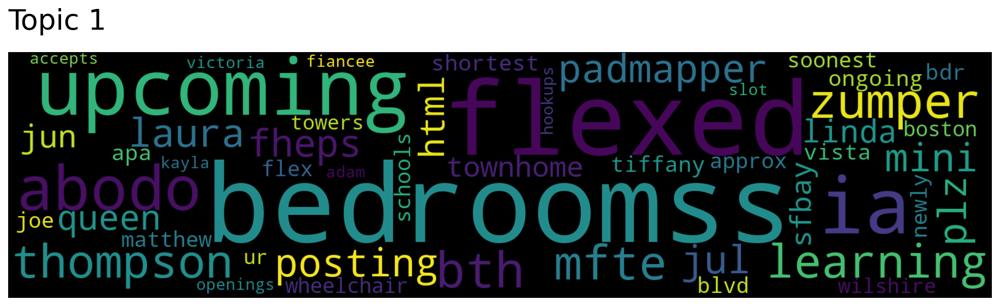

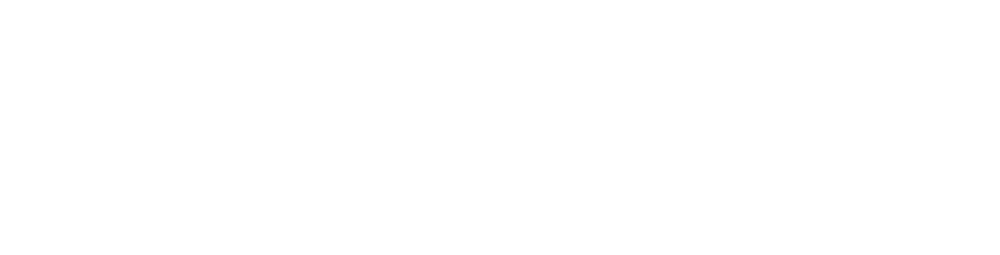

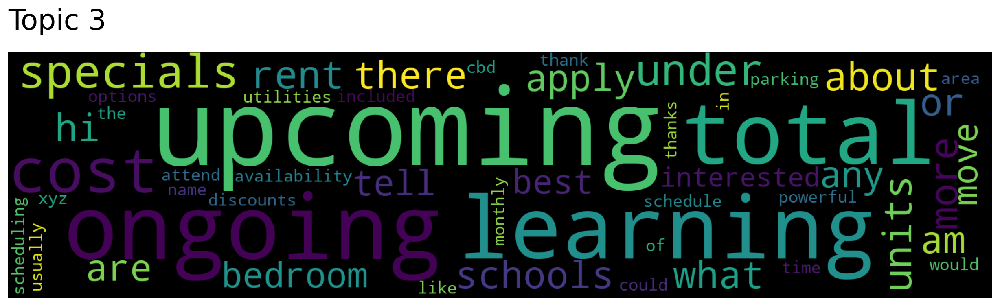

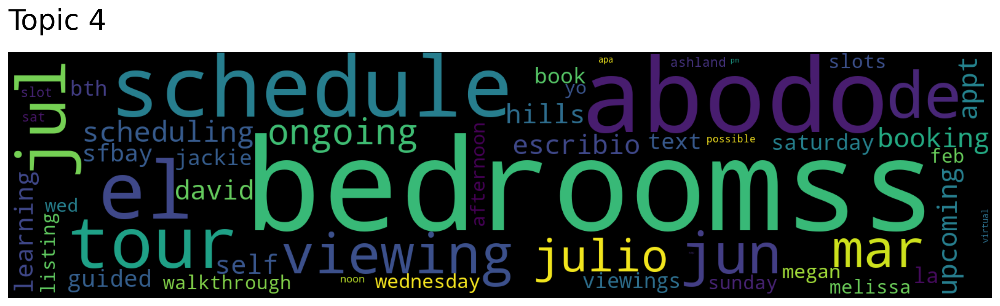

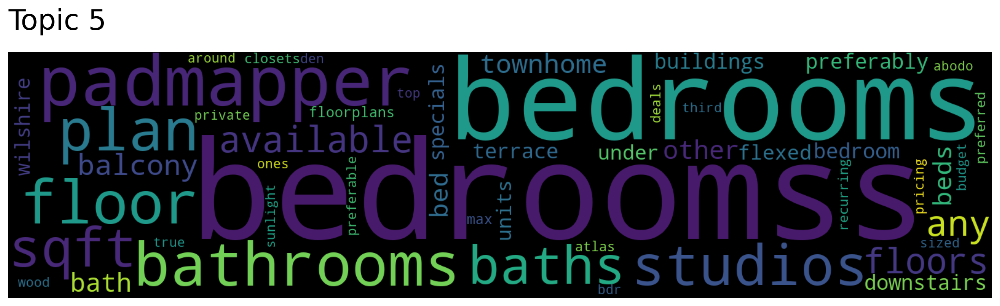

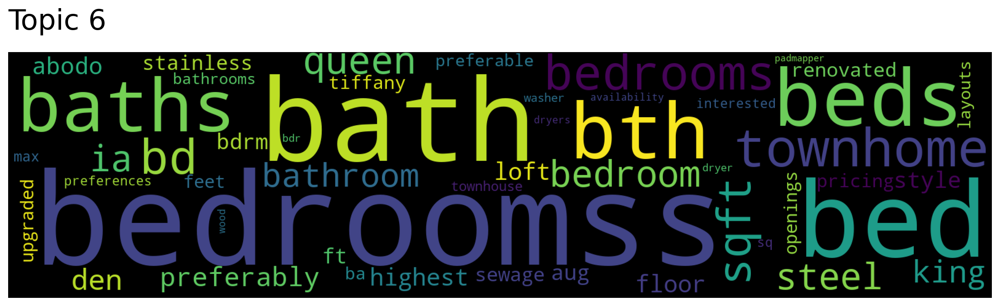

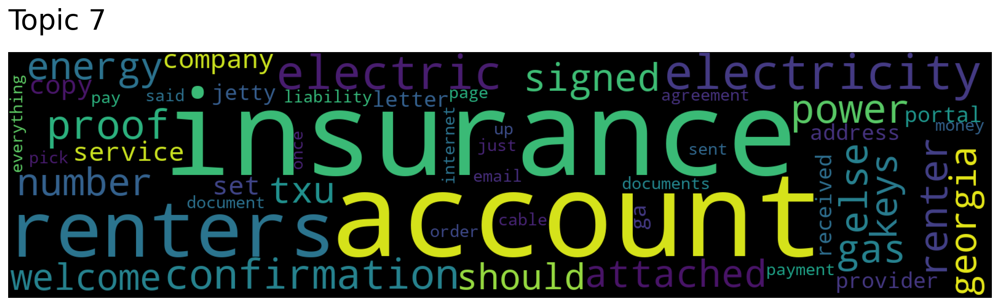

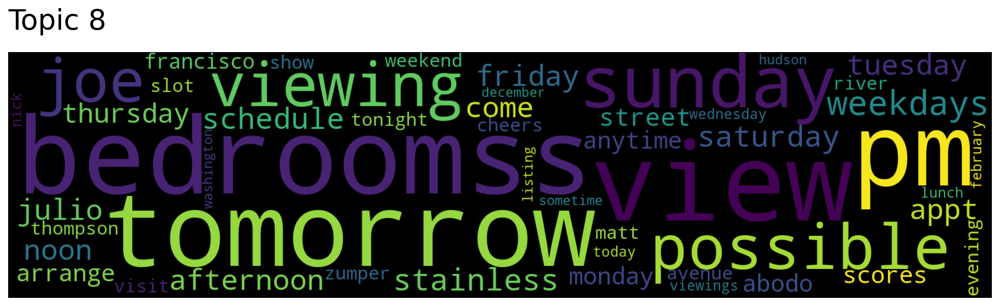

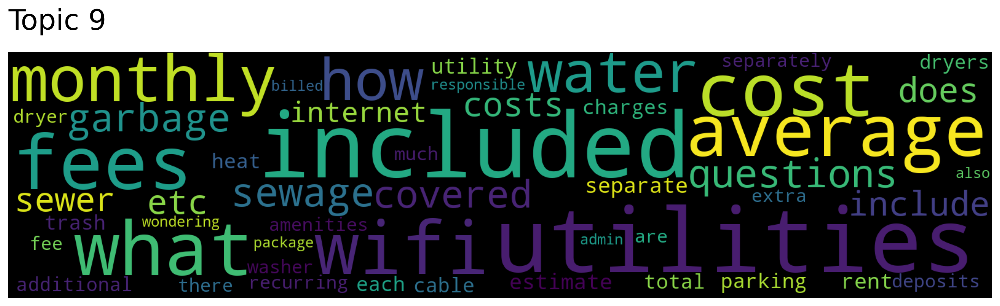

In [47]:
for topic_num in topic_nums:
    # a little buggy
    try:
        model.generate_topic_wordcloud(topic_num)
    except:
        pass

A lot of names are included, which is strange.

Most similar topics to "pets".

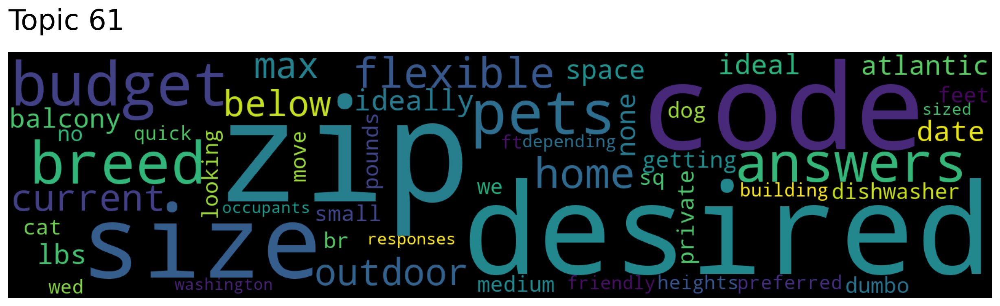

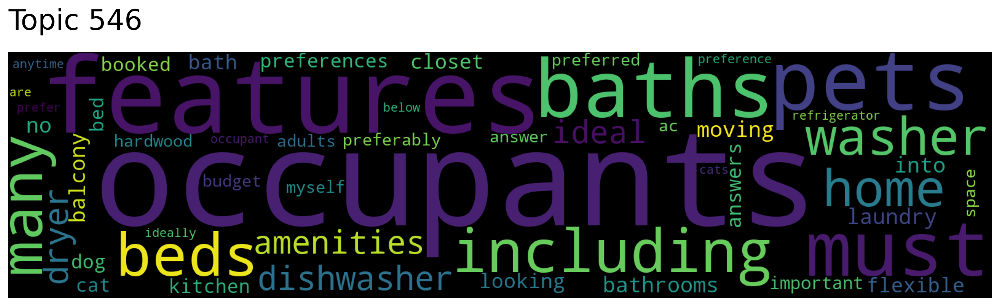

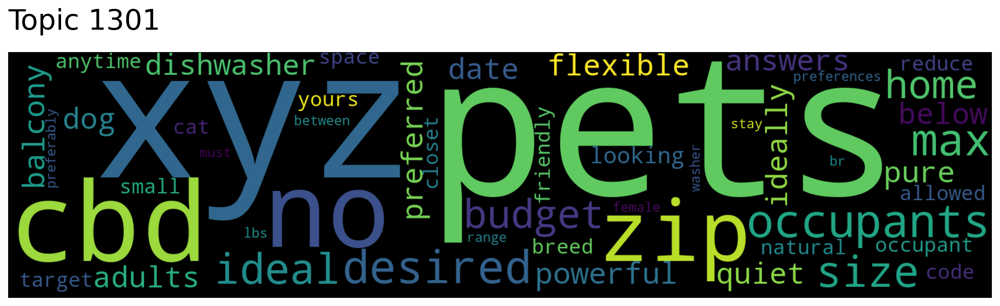

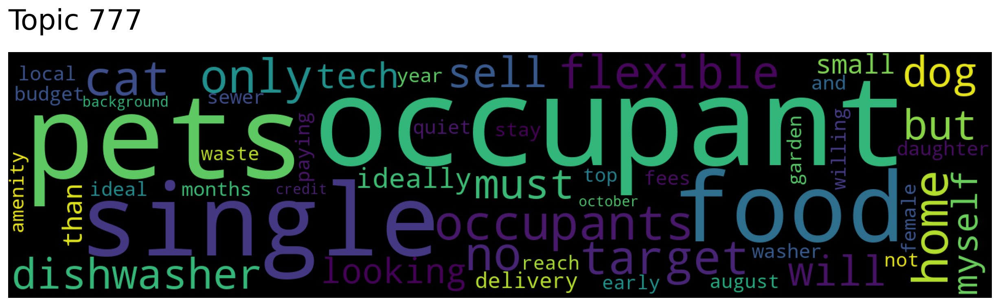

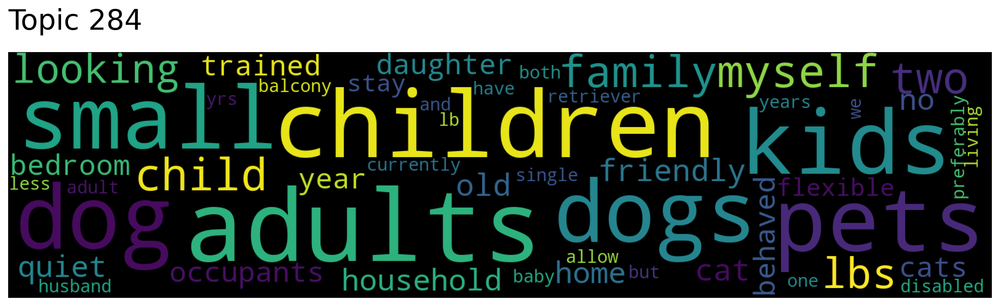

In [14]:
topic_words, word_scores, topic_scores, topic_nums = model.search_topics(keywords=["pets"], num_topics=5)
for topic in topic_nums:
    model.generate_topic_wordcloud(topic)

In [15]:
topic_nums

array([  61,  546, 1301,  777,  284])

In [16]:
topic_scores

array([0.4516, 0.4361, 0.4002, 0.3821, 0.3625])

Do the same for utilities.

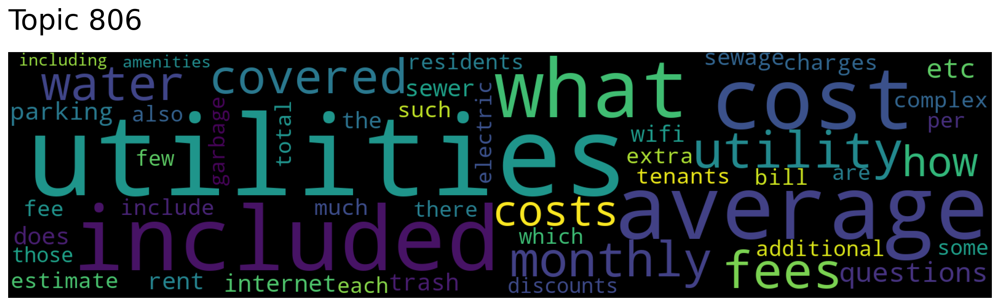

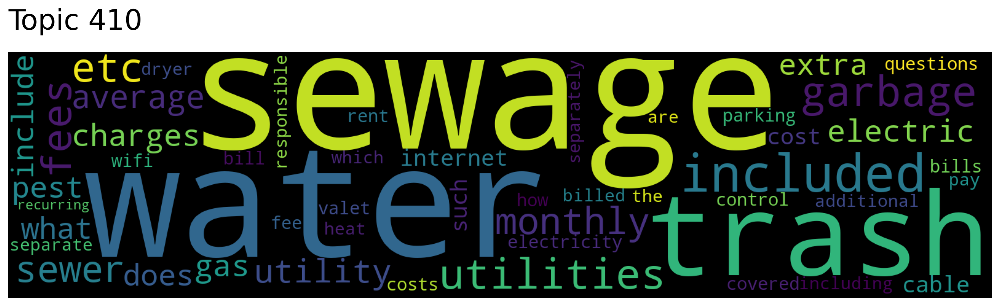

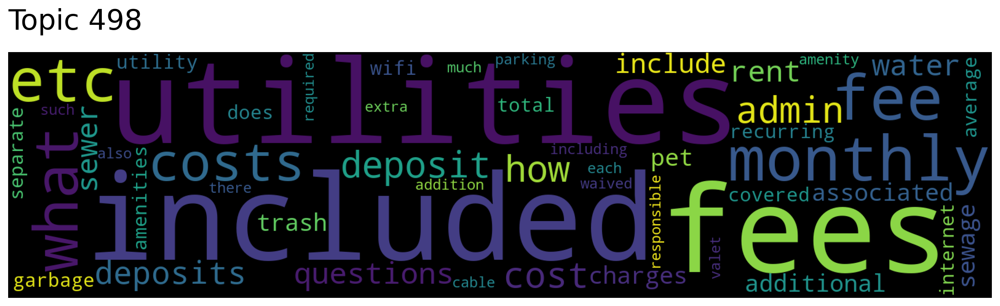

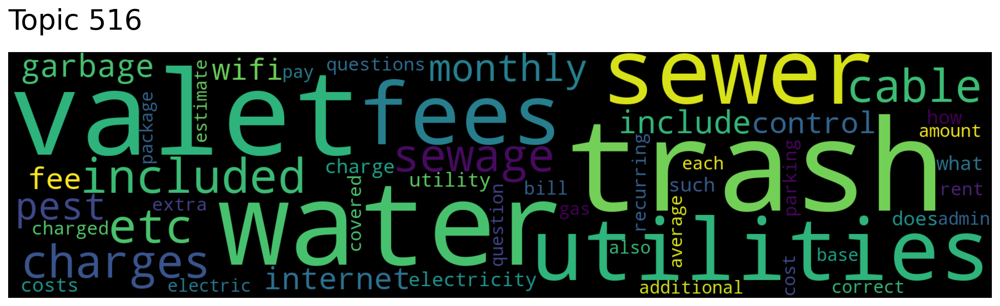

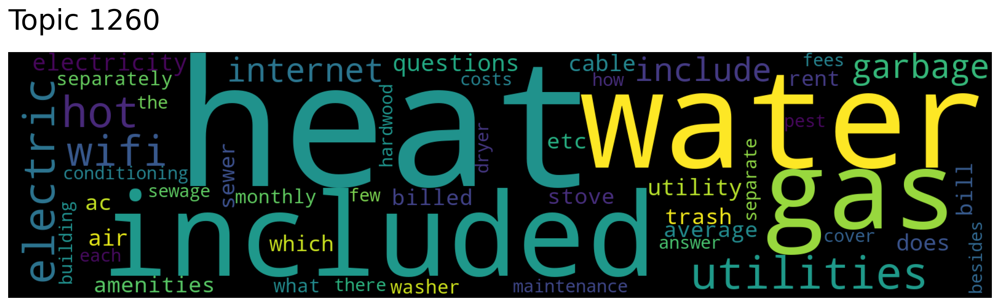

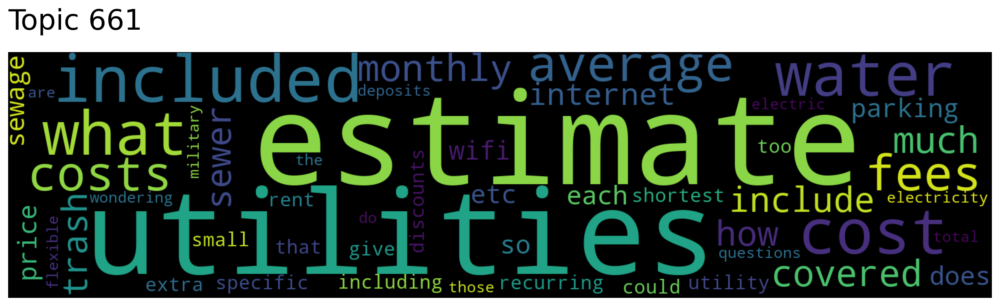

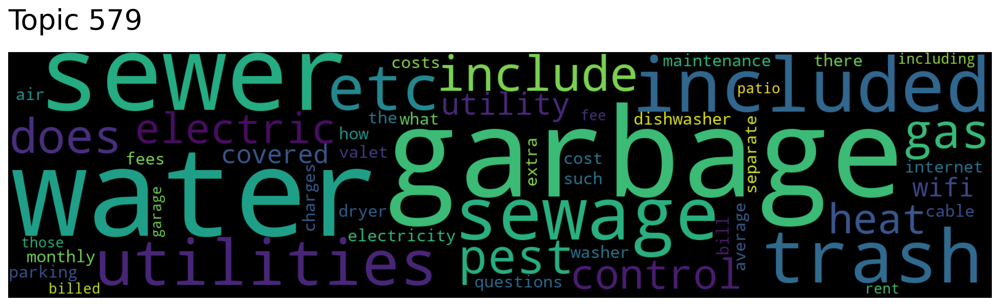

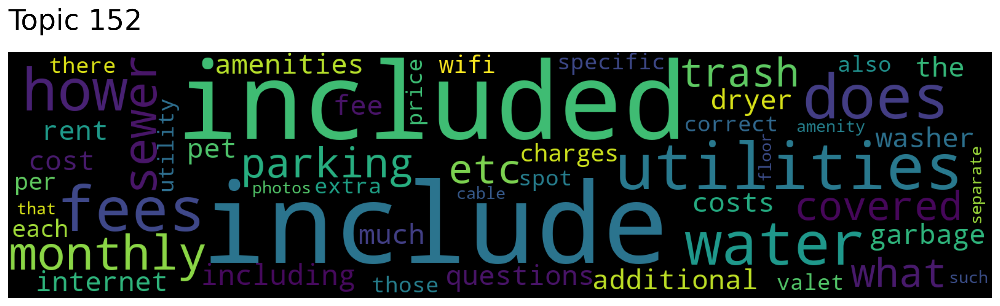

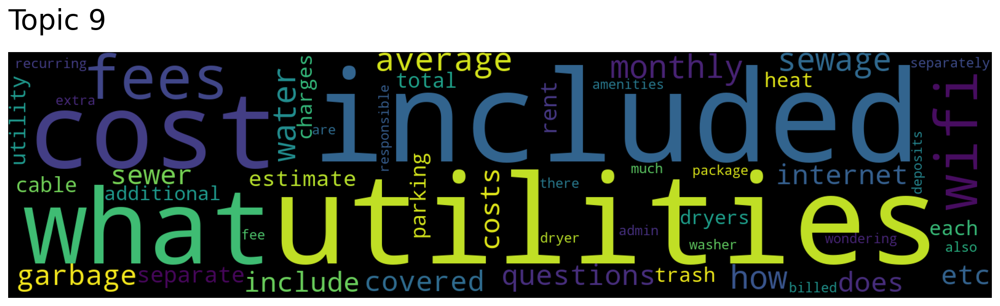

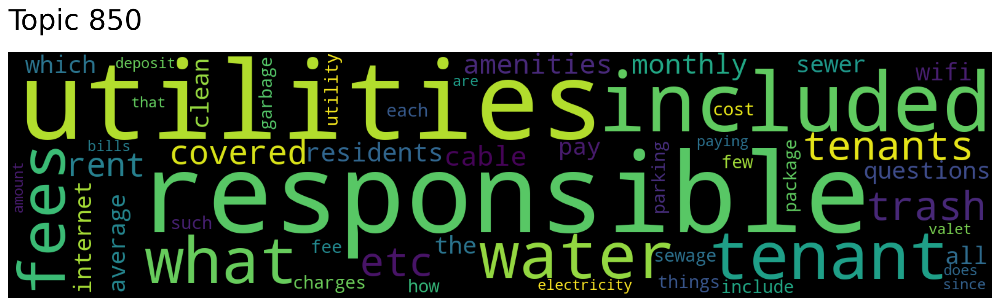

In [32]:
utilities_keywords = ["utilities"]

topic_words, word_scores, topic_scores, topic_nums = model.search_topics(
    keywords=utilities_keywords, num_topics=10)
for topic in topic_nums:
    model.generate_topic_wordcloud(topic)

In [33]:
topic_nums

array([ 806,  410,  498,  516, 1260,  661,  579,  152,    9,  850])

In [34]:
topic_sizes[topic_nums].sum()

853

Those top 10 topics only have 853 documents.

In [35]:
for topic_num in topic_nums:
    documents, document_scores, document_ids = model.search_documents_by_topic(
        topic_num=topic_num, num_docs=topic_sizes[topic_num])
    for doc, score, doc_id in zip(documents, document_scores, document_ids):
        print(f"Document: {doc_id}, Score: {score}")
        print("-----------")
        print(doc)
        print("-----------")
        print()

Document: 78644, Score: 0.9087544679641724
-----------
Could you tell me what average utilities are and how much garage rent is?
-----------

Document: 47467, Score: 0.9063756465911865
-----------
Are utilities included if not what’s the average price of a utilities ? What’s the deposit if there’s one ?
-----------

Document: 77705, Score: 0.9038882255554199
-----------
What is the average cost for a two bedroom? Are there any units available on the first floor?
-----------

Document: 63297, Score: 0.8931024074554443
-----------
Hi this is Audrey, Good morning. I was wondering how much is the average cost of utilities and pet fees are?
-----------

Document: 50232, Score: 0.8722503185272217
-----------
Thank you for the information!

This unit looks great. No pets, but could I get more information about parking?

I was also wondering how much on average utilities are?
-----------

Document: 65117, Score: 0.8721214532852173
-----------
We are interested in the 2bed 1.5 bath unit. Can yo

Thanks for your help!
-----------

Document: 45828, Score: 0.6065601110458374
-----------
hey all, my wife and I are interested in your 2 bedroom 918 sq ft and 1040 sq ft floor plans.  Can you please confirm that these are renovated?  If so, what do these renovations include?  Please also advise on any additional fees such as pet rent, parking spaces, required entertainment packages, etc.  Please also confirm the deposit amount.  Thank you!

My
-----------

Document: 27166, Score: 0.6060555577278137
-----------
Yes I’m interested in the 2 Bed 2 Bath floor plans . B1 and B2 could you tell me how much their renting for? And does the rent include anything like utilities , cable , water ? And does it come with washer and dryer ?
-----------

Document: 60793, Score: 0.6003385782241821
-----------
I would like more information on the remodeled 1 bedrooms including cost for utilities and dogs fees/rent prices. I also noticed there is a washer in unit in the video but not listed in the place, 

How about some others?

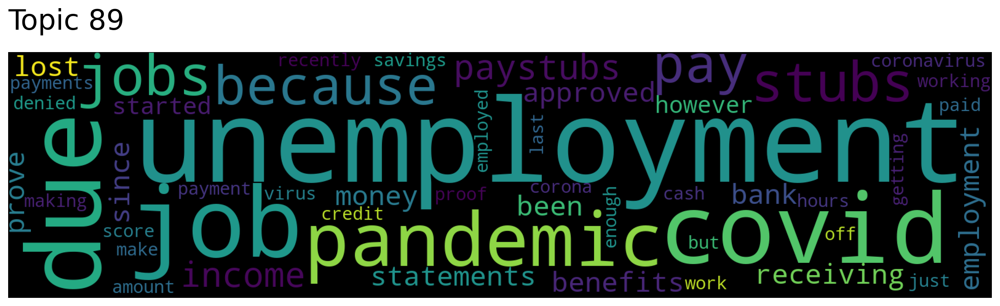

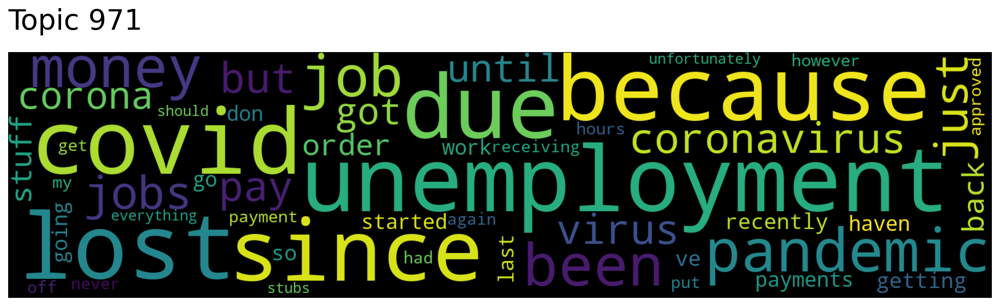

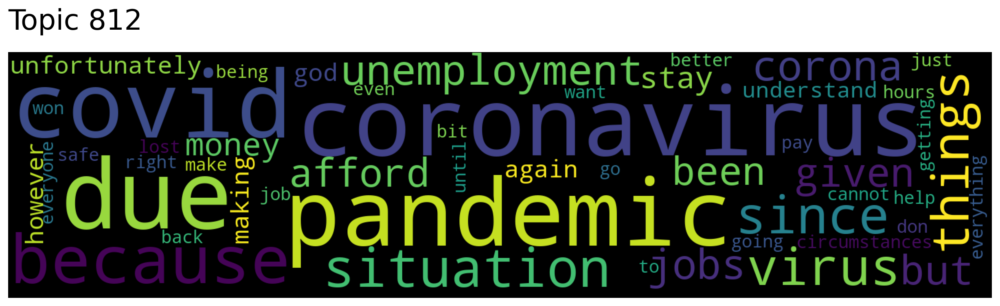

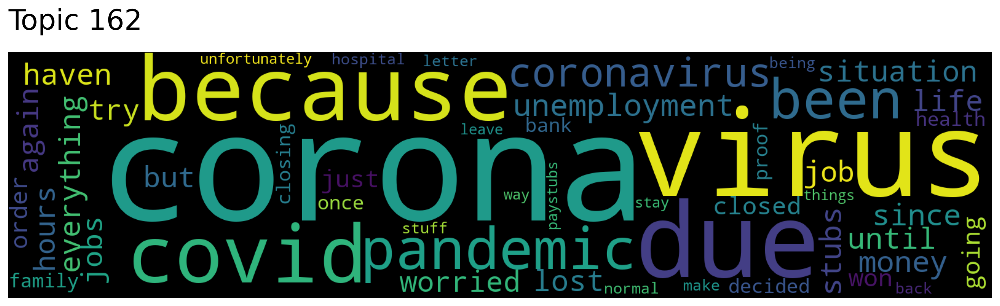

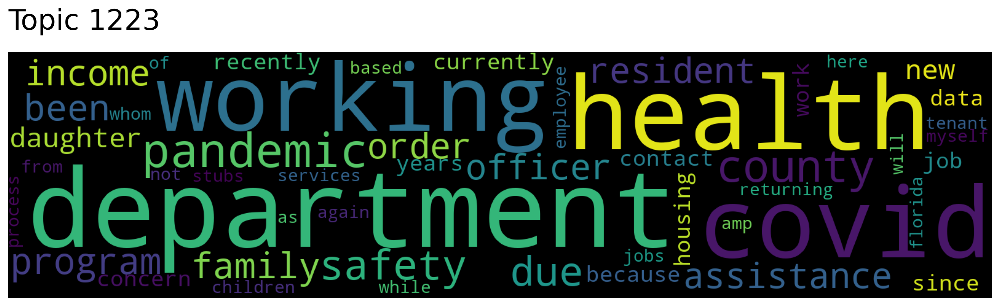

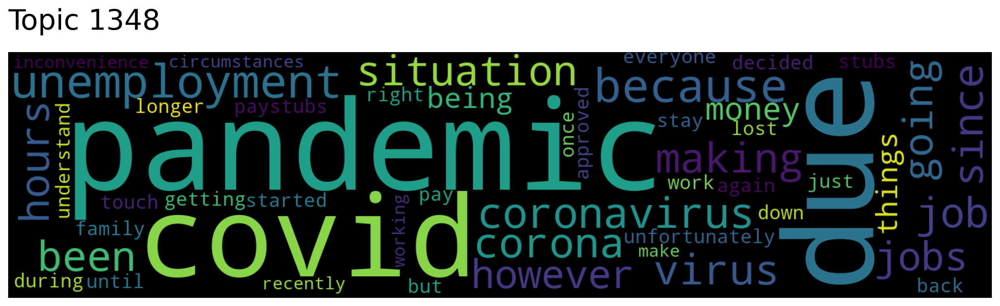

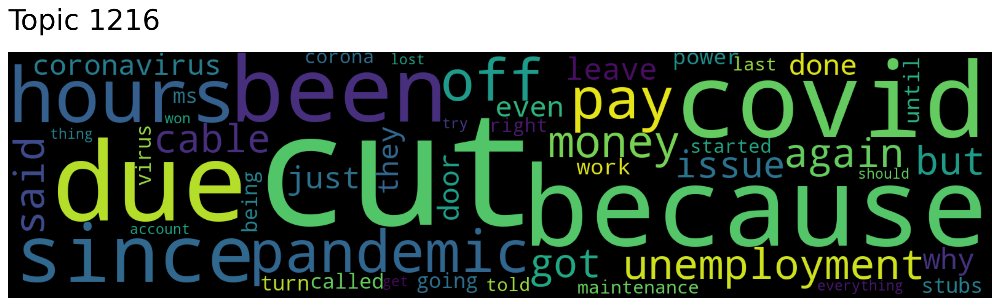

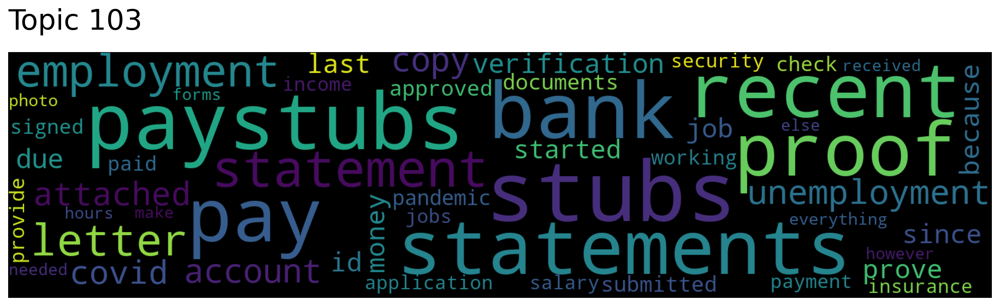

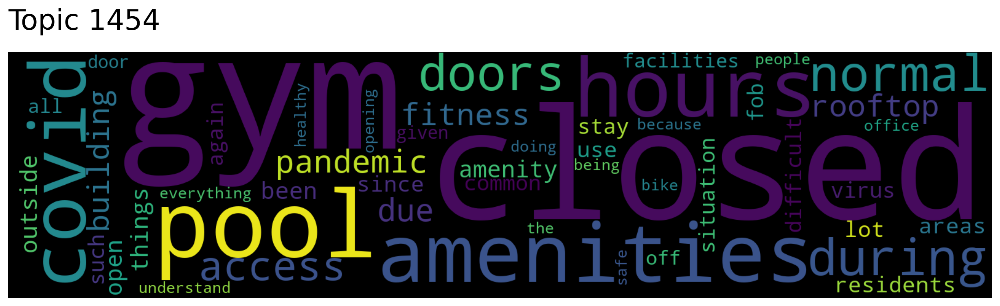

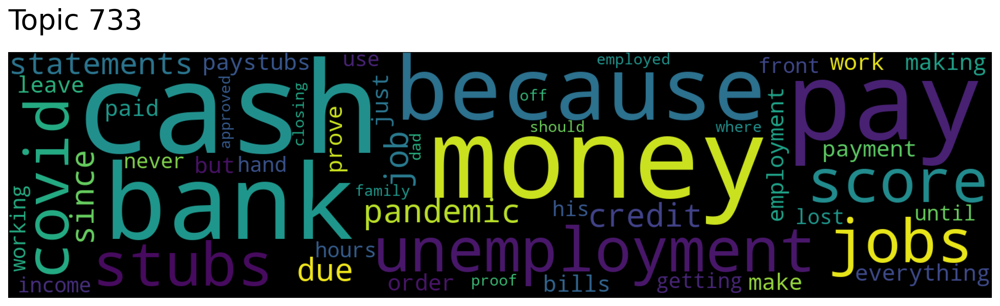

In [36]:
keywords = ["covid"]

topic_words, word_scores, topic_scores, topic_nums = model.search_topics(
    keywords=keywords, num_topics=10)
for topic in topic_nums:
    model.generate_topic_wordcloud(topic)

Get similar words.

In [48]:
words, word_scores = model.similar_words(keywords=["pets"], keywords_neg=[], num_words=20)
for word, score in zip(words, word_scores):
    print(f"{word} {score}")

home 0.5896
no 0.5574
flexible 0.503
in 0.4978
and 0.4974
looking 0.4908
date 0.4832
is 0.4831
move 0.4787
for 0.4767
have 0.4756
budget 0.4738
not 0.4618
am 0.4601
if 0.4598
dog 0.4586
small 0.456
below 0.4534
moving 0.4503
but 0.4493


In [49]:
words, word_scores = model.similar_words(keywords=["lease"], keywords_neg=[], num_words=20)
for word, score in zip(words, word_scores):
    print(f"{word} {score}")

months 0.6563
month 0.6525
the 0.625
to 0.6131
in 0.6107
term 0.5965
for 0.596
of 0.5955
and 0.5858
you 0.5814
my 0.567
also 0.5618
looking 0.5555
st 0.5534
rent 0.5484
so 0.5476
sign 0.5468
if 0.5468
will 0.5431
but 0.5424
